# Setup

In [1]:
from pathlib import Path
from tqdm import tqdm
import numpy as np
import zarr
from PIL import Image

import matplotlib.pyplot as plt
import seaborn as sns

import torch 
import random

In [2]:
data_path = Path('data/train/1/surface_volumes.zarr')
labels_path = Path('data/train/1/inklabels.png')
mask_path = Path('data/train/1/mask.png')
ir_path = Path('data/train/1/ir.png')

# Load Data

In [3]:
data = zarr.load(data_path)
with Image.open(labels_path) as im:
    labels = np.array(im)
with Image.open(mask_path) as im:
    mask = np.array(im)
with Image.open(ir_path) as im:
    ir = np.array(im)

# EDA

## Subvolume Analysis

Instead of comparing all ink vs non-ink across a slice, we're going to grab z-axis "columns" in a particular region bounded in 2d. Then, we'll see if regions containing more ink tend to have different voxel distribution.

In [4]:
box_size = (50,50)

all_ink_box = np.ones(box_size,dtype="uint8")
no_ink_box = np.zeros(box_size,dtype="uint8")

In [5]:
def get_subarray_occurances(subarray, array, mask=mask):
    occurances = []
    for i in tqdm(range(array.shape[0] - subarray.shape[0]+1)):
        for j in range(array.shape[1] - subarray.shape[1]+1):
            if np.all(array[i:i+subarray.shape[0], j:j+subarray.shape[1]] == subarray):
                if np.all(mask[i:i+subarray.shape[0], j:j+subarray.shape[1]] == 1):   
                    occurances.append((i, i+subarray.shape[0], j, j+subarray.shape[1]))
    return occurances
                    

In [6]:
all_ink_idx_list = get_subarray_occurances(all_ink_box, labels)

100%|███████████████████████████████████████| 8132/8132 [04:56<00:00, 27.39it/s]


In [7]:
no_ink_idx_list = get_subarray_occurances(no_ink_box, labels)

100%|███████████████████████████████████████| 8132/8132 [10:09<00:00, 13.33it/s]


In [8]:
def get_bounded_voxel_column(idx_tuple, voxel_array=data):
    return data[:,idx_tuple[0]:idx_tuple[1],idx_tuple[2]:idx_tuple[3]]

In [9]:
test_ink_col_idx = random.choices(all_ink_idx_list, k=1000)
test_ink_cols = np.array([get_bounded_voxel_column(idx_tuple) for idx_tuple in test_ink_col_idx])

test_no_ink_col_idx = random.choices(no_ink_idx_list, k=1000)
test_no_ink_cols = np.array([get_bounded_voxel_column(idx_tuple) for idx_tuple in test_no_ink_col_idx])

### Visualize one column

In [10]:
ink_col = test_ink_cols[0]
no_ink_col = test_no_ink_cols[0]

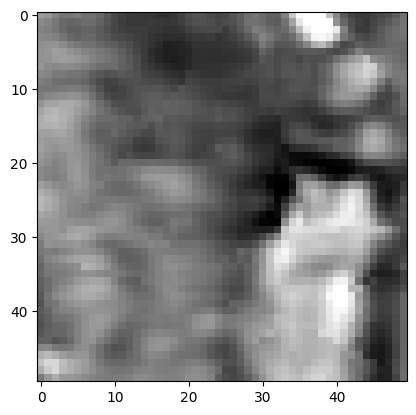

In [12]:
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

def update_plot(slice_idx, slice_array=no_ink_col):
    plt.cla()
    plt.title = f"slice {slice_idx}"
    plt.imshow(slice_array[slice_idx], cmap="gray")
    
fig = plt.figure()

animation = animation.FuncAnimation(fig, update_plot, no_ink_col.shape[0], blit=False)
animation

In [ ]:
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

def update_plot(slice_idx, slice_array=test_no_ink_cols.std(0)):
    plt.cla()
    plt.title = f"slice {slice_idx}"
    plt.imshow(slice_array[slice_idx], cmap="gray")
    
fig = plt.figure()

animation = animation.FuncAnimation(fig, update_plot, test_no_ink_cols.std(0).shape[0], blit=False)
animation

## Letter Analysis

In [6]:
letter_array = labels[2700:3350, 3100:3900]
letter_col = data[:,2700:3350, 3100:3900]

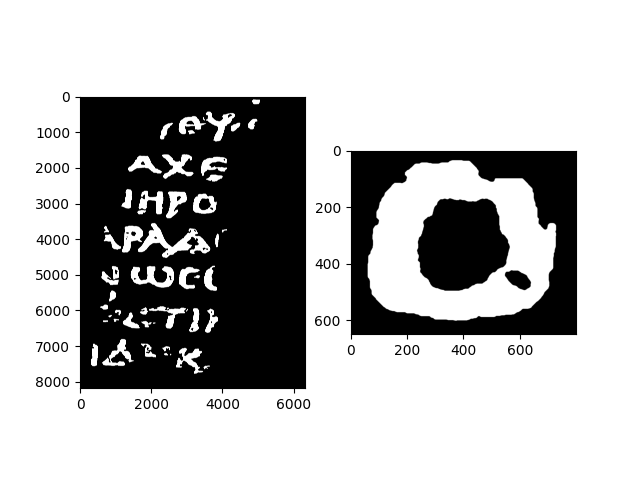

In [7]:
fig, axes = plt.subplots(1,2)
axes[0].imshow(labels,cmap="gray")
axes[1].imshow(letter_array, cmap="gray");

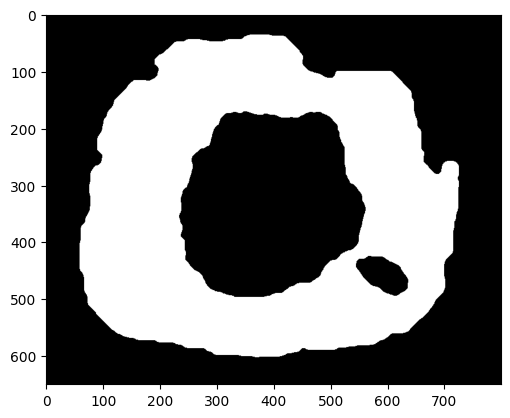

In [58]:
test = letter_array.copy()
plt.imshow(test, cmap="gray")

test_mask = (test == 1)
for row_idx, row in enumerate(test_mask):
    for col_idx, pixel_mask in enumerate(row):
        if pixel_mask:
            if row[col_idx-1] and row[col_idx+1] and test_mask[row_idx+1][col_idx] and test_mask[row_idx-1][col_idx]:
                test_mask[row_idx][col_idx] = 1
;

In [35]:
test_mask = (test == 1)
for row_idx, row in enumerate(test_mask):
    for col_idx, pixel_mask in enumerate(row):
        if pixel_mask:
            if row[col_idx-1] and row[col_idx+1] and test_mask[row_idx+1][col_idx] and test_mask[row_idx-1][col_idx]:
                test_mask[row_idx][col_idx] = 1

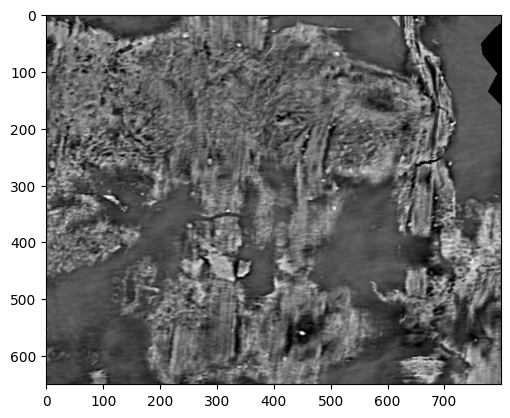

In [81]:
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

def update_plot(slice_idx, slice_array=letter_col):
    plt.cla()
    plt.title = f"slice {slice_idx}"
    plt.imshow(slice_array_copy[slice_idx], cmap="gray")
    
    
fig = plt.figure()

animation = animation.FuncAnimation(fig, update_plot, letter_col.shape[0], blit=False)
animation

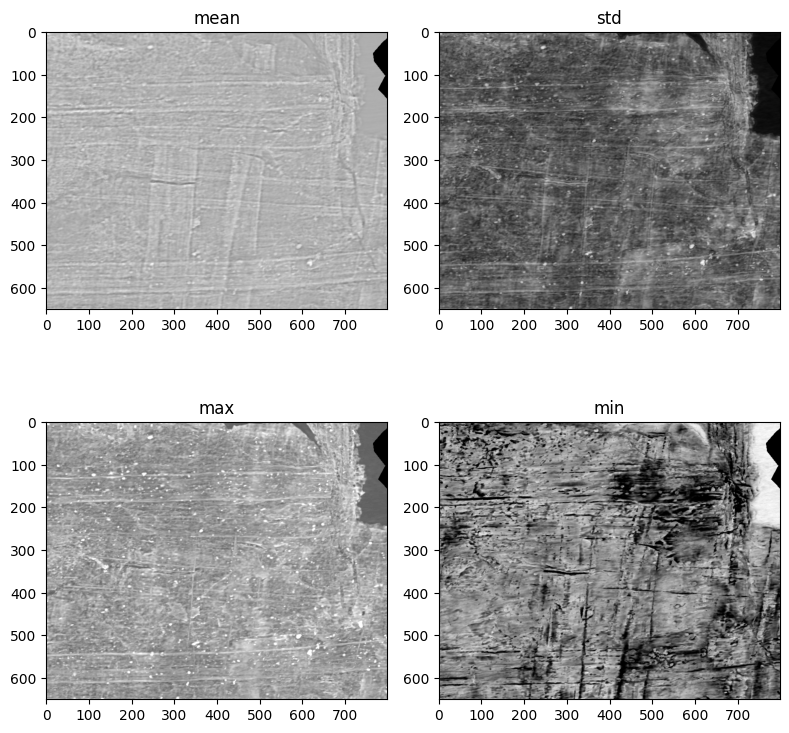

In [102]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2,2)

fig.set_size_inches((8,8))
ax1.set_title("mean")
ax1.imshow(letter_col.mean(0), cmap="gray")
ax2.set_title("std")
ax2.imshow(letter_col.std(0), cmap="gray")
ax3.set_title("max")
ax3.imshow(letter_col.max(0), cmap="gray")
ax4.set_title("min")
ax4.imshow(letter_col.min(0), cmap="gray")

plt.tight_layout();

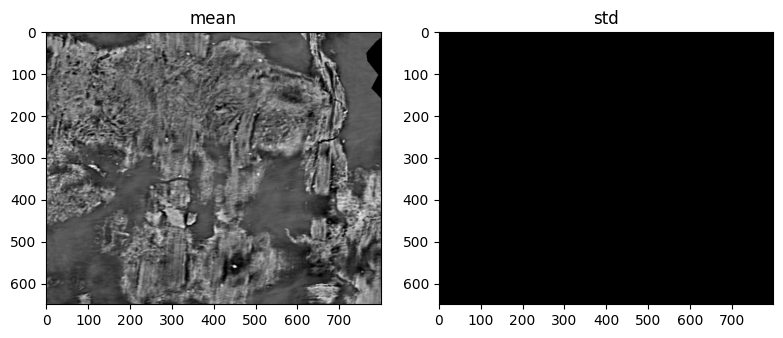

In [124]:
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')

def update_plot(slice_idx, slice_array=letter_col):
    plt.cla()  
    ax1.set_title("mean")
    ax1.imshow(letter_col[:slice_idx+1].mean(0), cmap="gray")
    ax2.set_title("std")
    ax2.imshow(letter_col[:slice_idx+1].std(0), cmap="gray")
    
fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches((8,8))
plt.tight_layout()

animation = animation.FuncAnimation(fig, update_plot, letter_col.shape[0], blit=False)
animation

In [ ]:
letter_col[:, ]

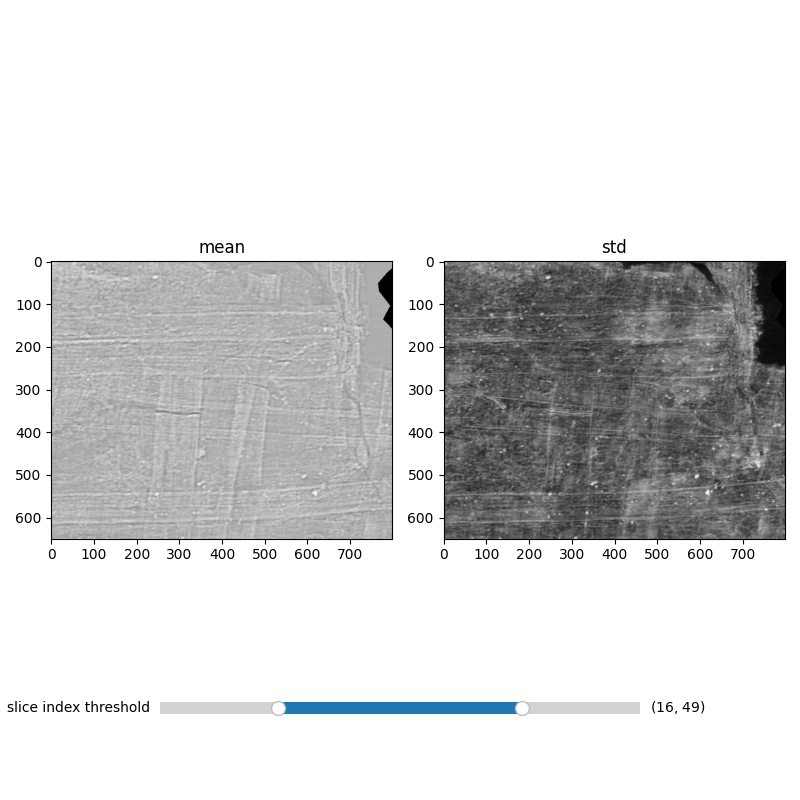

In [16]:
%matplotlib widget

from matplotlib.widgets import RangeSlider

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches((8,8))

ax1.set_title("mean")
ax1.imshow(letter_col.mean(0), cmap="gray")
ax2.set_title("std")
ax2.imshow(letter_col.std(0), cmap="gray")
plt.tight_layout()

def update(slice_idx, slice_array=letter_col):
    ax1.set_title("mean")
    ax1.imshow(letter_col[slice_idx[0]:slice_idx[1]+1].mean(0), cmap="gray")
    ax2.set_title("std")
    ax2.imshow(letter_col[slice_idx[0]:slice_idx[1]+1].std(0), cmap="gray")
    fig.canvas.draw_idle()
    
slider_ax = fig.add_axes([0.20, 0.1, 0.60, 0.03])
slider = RangeSlider(slider_ax, "slice index threshold", 0, letter_col.shape[0], valstep=np.arange(65))

slider.on_changed(update)
plt.show()

In [5]:
%pip install napari

  Using cached napari-0.4.17-py3-none-any.whl (2.6 MB)
  Using cached app_model-0.1.4-py3-none-any.whl (57 kB)
  Using cached cachey-0.2.1-py3-none-any.whl (6.4 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 1.2 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 11.2 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 7.2 MB/s eta 0:00:0000:0100:01
  Using cached magicgui-0.7.2-py3-none-any.whl (120 kB)
  Using cached napari_console-0.0.8-py3-none-any.whl (7.9 kB)
  Using cached napari_plugin_engine-0.2.0-py3-none-any.whl (33 kB)
  Using cached napari_svg-0.1.6-py3-none-any.whl (12 kB)
  Using cached npe2-0.7.0-py3-none-any.whl (92 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.4/52.4 kB 1.9 MB/s eta 0:00:00
  Using cached Pint-0.21-py3-none-any.whl (286 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.8/390.8 kB 8.2 MB/s eta 0:00:0000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 9.3 MB/s eta 0:00:00:00:0100:01
  Using cached lazy_loader-0.2-py3-none-any.whl (8.6 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 120.6/120.6 kB 2.6 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.7/84.7 kB 1.2 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.8/99.8 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.0/94.0 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.6/90.6 kB 395.3 kB/s eta 0:00:00a 0:00:01
  Using cached docutils-0.17.1-py2.py3-none-any.whl (575 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.0/93.0 kB 3.3 MB/s eta 0:00:00
  Using cached Babel-2.12.1-py3-none-any.whl (10.1 MB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 2.6 MB/s eta 0:00:00
  Using cached freetype_py-2.3.0-py3-none-macosx_10_9_universal2.whl (1.7 MB)
  Using cached hsluv-5.0.3-py2.py3-none-any.whl (5.1 kB)
     ━━━━━━━━━

  Created wheel for vispy: filename=vispy-0.11.0-cp311-cp311-macosx_10_9_x86_64.whl size=1393261 sha256=662e7fb84474fe5153b3c412ee814f23c347409d98e14335804521cebce51b22
  Stored in directory: /Users/mhk/Library/Caches/pip/wheels/39/0c/fa/db0ad594ef92767f2f3272fed2d25007e14e244b9d34f5374d
Successfully built vispy
  Attempting uninstall: qtconsole
    Found existing installation: qtconsole 5.4.2
    Uninstalling qtconsole-5.4.2:
      Successfully uninstalled qtconsole-5.4.2
Note: you may need to restart the kernel to use updated packages.


In [6]:
import napari
import skimage
viewer = napari.view_image(data, channel_axis=1, ndisplay=3)

In [17]:
from dask_image.imread import imread

stack = imread("data/train/1/surface_volumes/*.tif")
napari.view_image(stack, multiscale=False)

ValueError: A distribution name is required.

In [13]:
%pip install dask-image

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.9/41.9 kB 520.7 kB/s eta 0:00:0000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 2.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pims: filename=PIMS-0.6.1-py3-none-any.whl size=82621 sha256=0539cc62c163be2ad3b91b83fc833c0bd31fa50a9a8f81370c7fbb1497bd7687
  Stored in directory: /Users/mhk/Library/Caches/pip/wheels/c5/5b/24/5b815eb0250b3e8815ab8a8281fd5c10c6d26f677930d667d6
Successfully built pims
Note: you may need to restart the kernel to use updated packages.


# Analyze from lateral perspective

In [ ]:
data.shape

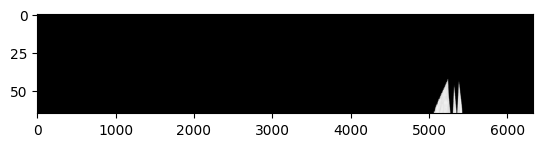

<Figure size 1000x2500 with 0 Axes>

In [20]:
fig, ax = plt.subplots(1,1)
plt.figure(figsize=(10, 25))
ax.imshow(data.reshape(8181,65, 6330)[0], cmap="gray")
ratio = 0.2
x_left, x_right = ax.get_xlim()
y_low, y_high = ax.get_ylim()
ax.set_aspect(abs((x_right-x_left)/(y_low-y_high))*ratio);

In [4]:
rolled = np.rollaxis(data, 2, 0)

sample = np.array([rolled[i,:,:] for i in range(rolled.shape[0]) if i % 10 == 0])
sample_x_coords = np.arange(0,rolled.shape[0], 10)

In [ ]:
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')


def update_plot(slice_idx, slice_array=sample, slice_x_coords=sample_x_coords):
    
    ax2.imshow(ir, cmap="gray")
    ax2.vlines(x = slice_x_coords[slice_idx], ymin = 0, ymax = data.shape[1], colors = 'green')
    ax2.set_ylim(data.shape[1],0)

    ax1.imshow(slice_array[slice_idx], cmap="gray")
    ax1.set_aspect(abs((x_right-x_left)/(y_low-y_high))*ratio)

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches((12,10))
ax1.set_ylim(0, data.shape[1])

animation = animation.FuncAnimation(fig, update_plot, sample.shape[0], blit=False)
animation

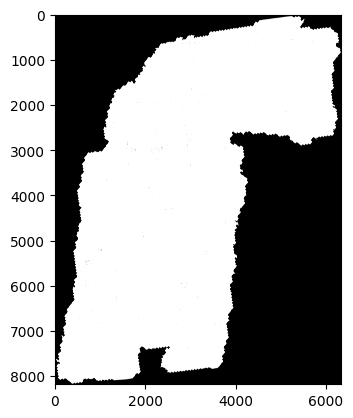

In [82]:
plt.imshow(np.clip(data[0], 0, 1), cmap="gray")

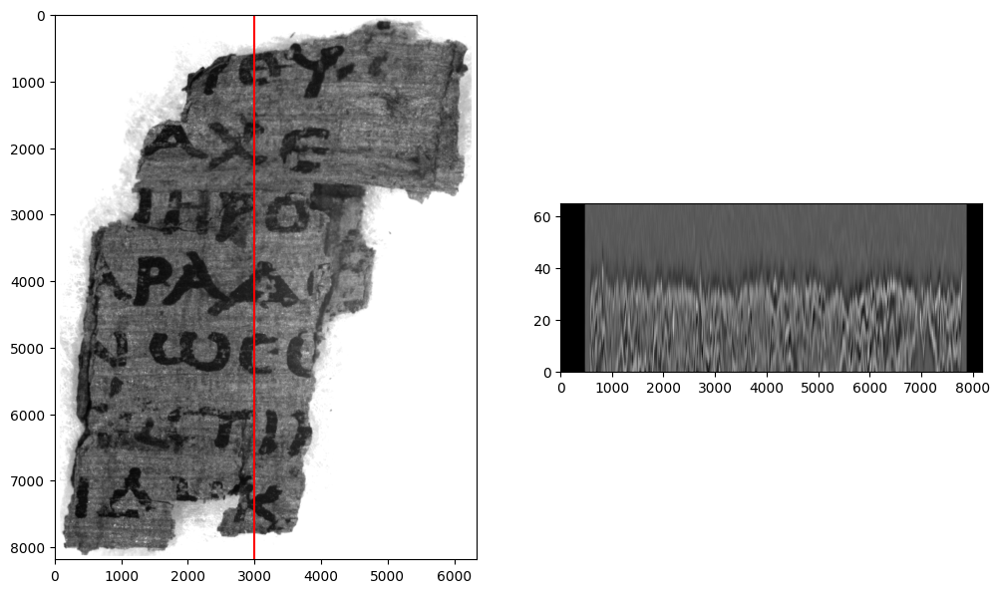

In [16]:
slice_idx = 3000

fig, axes = plt.subplots(1,2)
fig.set_size_inches((12,10))

axes[0].imshow(ir, cmap="gray")
axes[0].vlines(x = slice_idx, ymin = 0, ymax = data.shape[1], colors = 'red')
axes[0].set_ylim(data.shape[1],0)

axes[1].imshow(rolled[3000], cmap="gray")
axes[1].set_ylim(0, data.shape[0])
ratio = 0.4
x_left, x_right = axes[1].get_xlim()
y_low, y_high = axes[1].get_ylim()
axes[1].set_aspect(abs((x_right-x_left)/(y_low-y_high))*ratio);

In [12]:
rolled[3000][::-1,:]

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint16)

In [143]:
rolled = np.rollaxis(data, 2, 0)

In [144]:
rolled.shape

(6330, 65, 8181)

In [18]:
plt.imshow(ir)

NameError: name 'ir' is not defined